# Vit-GPT2, Image-Language Model Fine-Tuning - 02

In [1]:
import transformers
import torch
import accelerate
import evaluate
import matplotlib
import PIL
import csv
import nltk
import datasets
import numpy
import torchvision
import tqdm
import huggingface_hub
import torchaudio
import rouge_score
import jupyterlab
from datasets import load_dataset, Dataset
from pathlib import Path

import os
import datasets
import torch
from transformers import VisionEncoderDecoderModel, AutoFeatureExtractor,AutoTokenizer
from transformers import ViTImageProcessor
os.environ["WANDB_DISABLED"] = "true"
dir_prefix = '/g/data/wb00/admin/testing/nci-dl-train-dataset'
import warnings
warnings.filterwarnings('ignore')

In [2]:
%%time
from datasets import load_from_disk, Dataset

t_train_dataset = load_from_disk(f"{dir_prefix}/vit-gpt2/dataset/t_train_dataset.hf")
t_valid_dataset = load_from_disk(f"{dir_prefix}/vit-gpt2/dataset/t_valid_dataset.hf")

new_images = []
new_captions = []

for row in t_train_dataset:
    image = row['image']
    captions = row['captions']
    
    for caption in captions:
        new_images.append(image)
        new_captions.append(caption)

train_dataset = Dataset.from_dict({'image': new_images, 'captions': new_captions})

new_images = []
new_captions = []
for row in t_valid_dataset:
    image = row['image']
    captions = row['captions']
    
    for caption in captions:
        new_images.append(image)
        new_captions.append(caption)

valid_dataset = Dataset.from_dict({'image': new_images, 'captions': new_captions})

CPU times: user 6min 2s, sys: 8.66 s, total: 6min 10s
Wall time: 6min 10s


In [3]:
import nltk
nltk.data.path.append(f"{dir_prefix}/vit-gpt2/nltk_data")
try:
    nltk.data.find("tokenizers/punkt")
except (LookupError, OSError):
    #nltk.download("punkt", quiet=True)
    print ("nltk punkt not found")

In [4]:
model = VisionEncoderDecoderModel.from_pretrained(f"{dir_prefix}/vit-gpt2/nlpconnect/vit-gpt2-image-captioning")
feature_extractor = ViTImageProcessor.from_pretrained(f"{dir_prefix}/vit-gpt2/nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained(f"{dir_prefix}/vit-gpt2/nlpconnect/vit-gpt2-image-captioning")

In [5]:
model.generation_config.pad_token_id = tokenizer.pad_token_id

In [6]:
class ImageCapationingDataset(torch.utils.data.Dataset):
    def __init__(self, ds, max_target_length):
        self.ds = ds
        self.max_target_length = max_target_length

    def __getitem__(self, idx):
        model_inputs = {}
        image = self.ds[idx]["image"]
        image_encoded = feature_extractor(images=image, return_tensors="np").pixel_values[0]
        labels = tokenizer(self.ds[idx]["captions"], 
                  padding="max_length", truncation=True,
                  max_length=self.max_target_length).input_ids
        # This contains image path column
        model_inputs['labels'] = labels
        model_inputs['pixel_values'] = image_encoded

        return model_inputs

    def __len__(self):
        return len(self.ds)

In [7]:
train_ds = ImageCapationingDataset(train_dataset, 64)
eval_ds = ImageCapationingDataset(valid_dataset, 64)

In [8]:
from transformers import Seq2SeqTrainer, Seq2SeqTrainingArguments

training_args = Seq2SeqTrainingArguments(
    predict_with_generate=True,
    evaluation_strategy="epoch",
    per_device_train_batch_size= 64, #32,
    per_device_eval_batch_size= 64, # 32,
    #output_dir="/g/data/wb00/admin/testing/vit-gpt2/image-captioning-output/",
    output_dir="/tmp/vit-gpt2/image-captioning-output/",
    
    save_total_limit = 1, #5,  # You can adjust this based on your requirements
    learning_rate = 5e-5,  # Adjust as needed
    lr_scheduler_type = "reduce_lr_on_plateau",  # Specify the scheduler type
    save_strategy = "epoch",  # You can adjust this based on your requirements
    num_train_epochs = 1, #3,
)

Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


In [9]:
metric = evaluate.load(f"{dir_prefix}/vit-gpt2/modules/evaluate_modules/metrics/evaluate-metric--rouge/rouge.py")

In [10]:
import numpy as np

ignore_pad_token_for_loss = True

def postprocess_text(preds, labels):
    preds = [pred.strip() for pred in preds]
    labels = [label.strip() for label in labels]

    # rougeLSum expects newline after each sentence
    preds = ["\n".join(nltk.sent_tokenize(pred)) for pred in preds]
    labels = ["\n".join(nltk.sent_tokenize(label)) for label in labels]

    return preds, labels

def compute_metrics(eval_preds):
    preds, labels = eval_preds
    if isinstance(preds, tuple):
        preds = preds[0]
    decoded_preds = tokenizer.batch_decode(preds, skip_special_tokens=True)
    if ignore_pad_token_for_loss:
        # Replace -100 in the labels as we can't decode them.
        labels = np.where(labels != -100, labels, tokenizer.pad_token_id)
    decoded_labels = tokenizer.batch_decode(labels, skip_special_tokens=True)

    # Some simple post-processing
    decoded_preds, decoded_labels = postprocess_text(decoded_preds,
                                                     decoded_labels)

    result = metric.compute(predictions=decoded_preds,
                            references=decoded_labels,
                            use_stemmer=True)
    result = {k: round(v * 100, 4) for k, v in result.items()}
    prediction_lens = [
        np.count_nonzero(pred != tokenizer.pad_token_id) for pred in preds
    ]
    result["gen_len"] = np.mean(prediction_lens)
    return result

In [11]:
#from transformers import AdamW, get_scheduler
from transformers import get_scheduler
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau

optimizer = AdamW(model.parameters(), lr=training_args.learning_rate)

scheduler = ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=3,
    verbose=True
)

In [12]:
model.generation_config.pad_token_id = tokenizer.pad_token_id

In [13]:
from transformers import default_data_collator
# instantiate trainer
trainer = Seq2SeqTrainer(
    model=model,
    tokenizer=feature_extractor,
    args=training_args,
    compute_metrics=compute_metrics,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    data_collator=default_data_collator,
    optimizers=(optimizer, scheduler),
)

Detected kernel version 4.18.0, which is below the recommended minimum of 5.5.0; this can cause the process to hang. It is recommended to upgrade the kernel to the minimum version or higher.


In [14]:
%%time
trainer.train()

We strongly recommend passing in an `attention_mask` since your input_ids may be padded. See https://huggingface.co/docs/transformers/troubleshooting#incorrect-output-when-padding-tokens-arent-masked.
You may ignore this warning if your `pad_token_id` (50256) is identical to the `bos_token_id` (50256), `eos_token_id` (50256), or the `sep_token_id` (None), and your input is not padded.


Epoch,Training Loss,Validation Loss,Rouge1,Rouge2,Rougel,Rougelsum,Gen Len
1,0.349400,0.318307,44.397400,22.603000,38.035000,38.046300,12.149909


The attention mask is not set and cannot be inferred from input because pad token is same as eos token.As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


CPU times: user 15min 55s, sys: 1min 19s, total: 17min 14s
Wall time: 17min 14s


TrainOutput(global_step=683, training_loss=0.3281423644125898, metrics={'train_runtime': 1034.0503, 'train_samples_per_second': 42.232, 'train_steps_per_second': 0.661, 'total_flos': 7.88085812521599e+18, 'train_loss': 0.3281423644125898, 'epoch': 1.0})

In [15]:
from matplotlib import pyplot as plt
from nltk.translate.bleu_score import sentence_bleu

res = []
max_length = 64
num_beams = 4
gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
for i, example in enumerate(t_valid_dataset):
    reference = [ caption.split() for caption in example["captions"] ] 
    image = example["image"]
    pixel_values = feature_extractor(images=image, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to("cuda")

    output_ids = model.generate(pixel_values, **gen_kwargs)

    preds = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    preds = [pred.strip() for pred in preds][0]
    res.append(sentence_bleu(reference, preds.split()))
    
print(sum(res) / len(res))

0.30579085094988234


In [16]:
shuffled_dataset = t_valid_dataset.shuffle()  

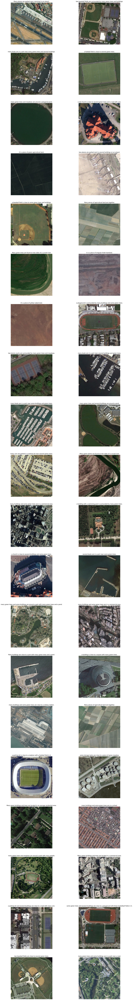

In [17]:
from matplotlib import pyplot as plt
from nltk.translate.bleu_score import sentence_bleu

fig, axs = plt.subplots(20, 2, figsize=(20, 160))

res = []
max_length = 64
num_beams = 4
gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
for i, example in enumerate(shuffled_dataset):
    ax = axs[i // 2, i % 2]
    
    reference = [ caption.split() for caption in example["captions"] ] 
    image = example["image"]
    pixel_values = feature_extractor(images=image, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to("cuda")

    output_ids = model.generate(pixel_values, **gen_kwargs)

    preds = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    preds = [pred.strip() for pred in preds][0]
    res.append(sentence_bleu(reference, preds.split()))
    ax.imshow(image)
    ax.axis('off')
    ax.set_title( preds )
    
    if i >= 39: #19:
        break 